# Исследование объявлений о продаже квартир

>*Петербург грабит города, влюбляя в себя людей и забирая их насовсем.*



### Откройте файл с данными и изучите общую информацию. 

>*Мало кто знает, но в Питере говорят не «хурма», а «хаверма»*

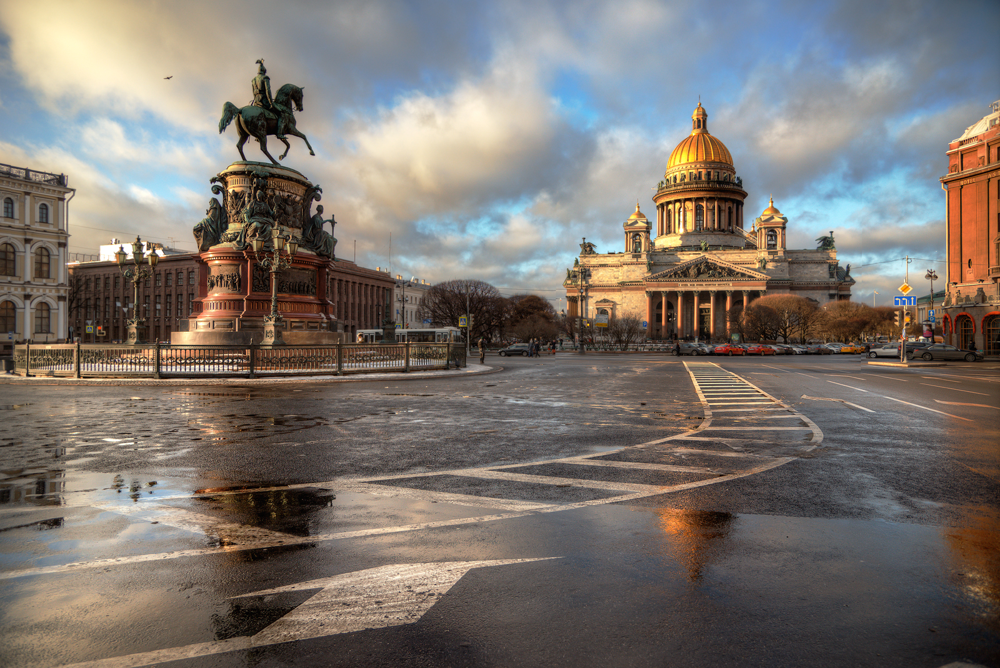

**Импортируем необходимые библиотеки**

In [1]:
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt

**В переменную df запишем данные из таблицы, которую прочли с помощью библиотеки pandas, разделитель таблицы - '\t'**

In [2]:
df = pd.read_csv('/datasets/real_estate_data.csv', sep='\t')

**Выведем первые строки**

In [3]:
df.head()

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
0,20,13000000.0,108.0,2019-03-07T00:00:00,3,2.70,16.0,51.0,8,NaN,...,25.0,NaN,Санкт-Петербург,18863.0,16028.0,1.0,482.0,2.0,755.0,NaN
1,7,3350000.0,40.4,2018-12-04T00:00:00,1,NaN,11.0,18.6,1,NaN,...,11.0,2.0,посёлок Шушары,12817.0,18603.0,0.0,NaN,0.0,NaN,81.0
2,10,5196000.0,56.0,2015-08-20T00:00:00,2,NaN,5.0,34.3,4,NaN,...,8.3,0.0,Санкт-Петербург,21741.0,13933.0,1.0,90.0,2.0,574.0,558.0
3,0,64900000.0,159.0,2015-07-24T00:00:00,3,NaN,14.0,NaN,9,NaN,...,NaN,0.0,Санкт-Петербург,28098.0,6800.0,2.0,84.0,3.0,234.0,424.0
4,2,10000000.0,100.0,2018-06-19T00:00:00,2,3.03,14.0,32.0,13,NaN,...,41.0,NaN,Санкт-Петербург,31856.0,8098.0,2.0,112.0,1.0,48.0,121.0


**Посмотрим общую информацию о датафрейме методом `info()`**

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23699 entries, 0 to 23698
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   total_images          23699 non-null  int64  
 1   last_price            23699 non-null  float64
 2   total_area            23699 non-null  float64
 3   first_day_exposition  23699 non-null  object 
 4   rooms                 23699 non-null  int64  
 5   ceiling_height        14504 non-null  float64
 6   floors_total          23613 non-null  float64
 7   living_area           21796 non-null  float64
 8   floor                 23699 non-null  int64  
 9   is_apartment          2775 non-null   object 
 10  studio                23699 non-null  bool   
 11  open_plan             23699 non-null  bool   
 12  kitchen_area          21421 non-null  float64
 13  balcony               12180 non-null  float64
 14  locality_name         23650 non-null  object 
 15  airports_nearest   

**Описание данных**
- `airports_nearest` — расстояние до ближайшего аэропорта в метрах (м)
- `balcony` — число балконов
- `ceiling_height` — высота потолков (м)
- `cityCenters_nearest` — расстояние до центра города (м)
- `days_exposition` — сколько дней было размещено объявление (от публикации до снятия)
- `first_day_exposition` — дата публикации
- `floor` — этаж
- `floors_total` — всего этажей в доме
- `is_apartment` — апартаменты (булев тип)
- `kitchen_area` — площадь кухни в квадратных метрах (м²)
- `last_price` — цена на момент снятия с публикации
- `living_area` — жилая площадь в квадратных метрах (м²)
- `locality_name` — название населённого пункта
- `open_plan` — свободная планировка (булев тип)
- `parks_around3000` — число парков в радиусе 3 км
- `parks_nearest` — расстояние до ближайшего парка (м)
- `ponds_around3000` — число водоёмов в радиусе 3 км
- `ponds_nearest` — расстояние до ближайшего водоёма (м)
- `rooms` — число комнат
- `studio` — квартира-студия (булев тип)
- `total_area` — общая площадь квартиры в квадратных метрах (м²)
- `total_images` — число фотографий квартиры в объявлении

**Посмотрим основные статистические данные о столбцах**

In [5]:
round(df.describe(), 2)

,total_images,last_price,total_area,rooms,ceiling_height,floors_total,living_area,floor,kitchen_area,balcony,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
count,23699.00,2.369900e+04,23699.00,23699.00,14504.00,23613.00,21796.00,23699.00,21421.00,12180.00,18157.00,18180.00,18181.00,8079.00,18181.00,9110.00,20518.00
mean,9.86,6.541549e+06,60.35,2.07,2.77,10.67,34.46,5.89,10.57,1.15,28793.67,14191.28,0.61,490.80,0.77,517.98,180.89
std,5.68,1.088701e+07,35.65,1.08,1.26,6.60,22.03,4.89,5.91,1.07,12630.88,8608.39,0.80,342.32,0.94,277.72,219.73
min,0.00,1.219000e+04,12.00,0.00,1.00,1.00,2.00,1.00,1.30,0.00,0.00,181.00,0.00,1.00,0.00,13.00,1.00
25%,6.00,3.400000e+06,40.00,1.00,2.52,5.00,18.60,2.00,7.00,0.00,18585.00,9238.00,0.00,288.00,0.00,294.00,45.00
50%,9.00,4.650000e+06,52.00,2.00,2.65,9.00,30.00,4.00,9.10,1.00,26726.00,13098.50,0.00,455.00,1.00,502.00,95.00
75%,14.00,6.800000e+06,69.90,3.00,2.80,16.00,42.30,8.00,12.00,2.00,37273.00,16293.00,1.00,612.00,1.00,729.00,232.00
max,50.00,7.630000e+08,900.00,19.00,100.00,60.00,409.70,33.00,112.00,5.00,84869.00,65968.00,3.00,3190.00,3.00,1344.00,1580.00


**Построим гистограммы по всем столбцам датафрейма**

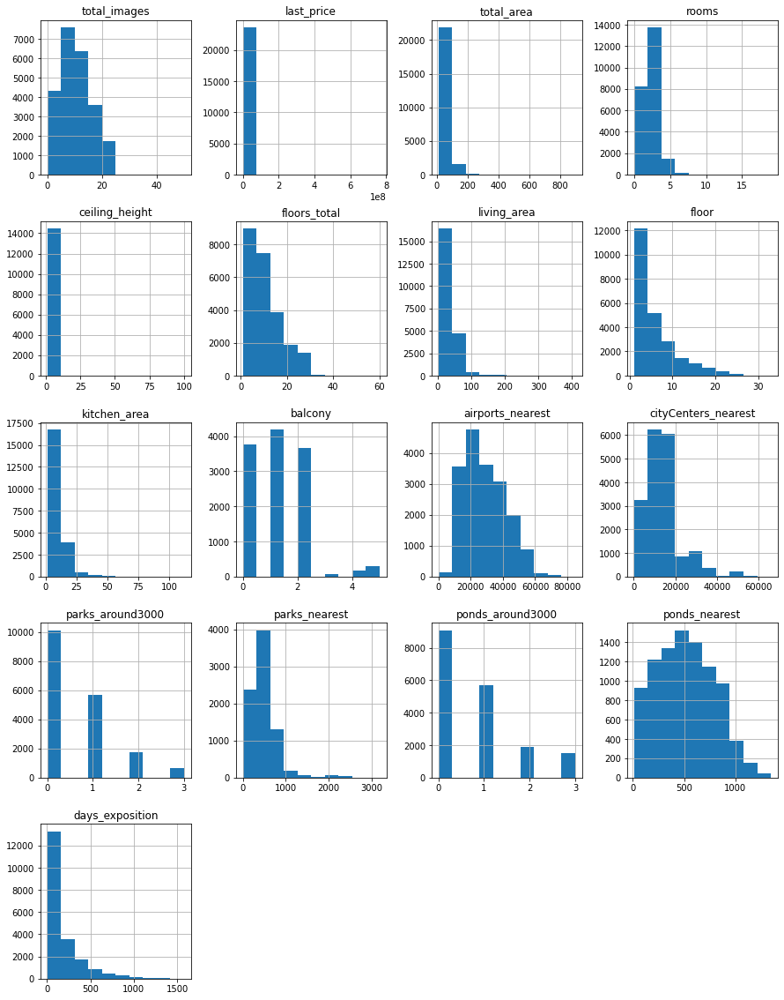

In [6]:
df.hist(figsize=(15, 20))
plt.show()

**Вывод**

`` Наблюдения:
• Датафрейм имеет 23699 строк и 22 столбца
• 14 столбцов датафрейма имеют пропуски
• Некоторые данные имеют тип данных некоректный для данных в столбце:
    тип данных столбца `first_day_exposition` должен быть тип datetime, 
    столбцов `floors_total`, `parks_around3000`, `ponds_around3000 `, `days_exposition `, `balcony ` должны быть int,
    столбца `is_apartment` должен быть типа bool.
``

### Предобработка данных

>*Только в Петербурге в особенностях сдаваемой квартиры, помимо метража и отделки — может быть пункт: «Интеллигентные соседи».*

>*На чемпионате мира по вежливости победил питерский алкоголик Сергей, которому не хватало двадцати рублей.*

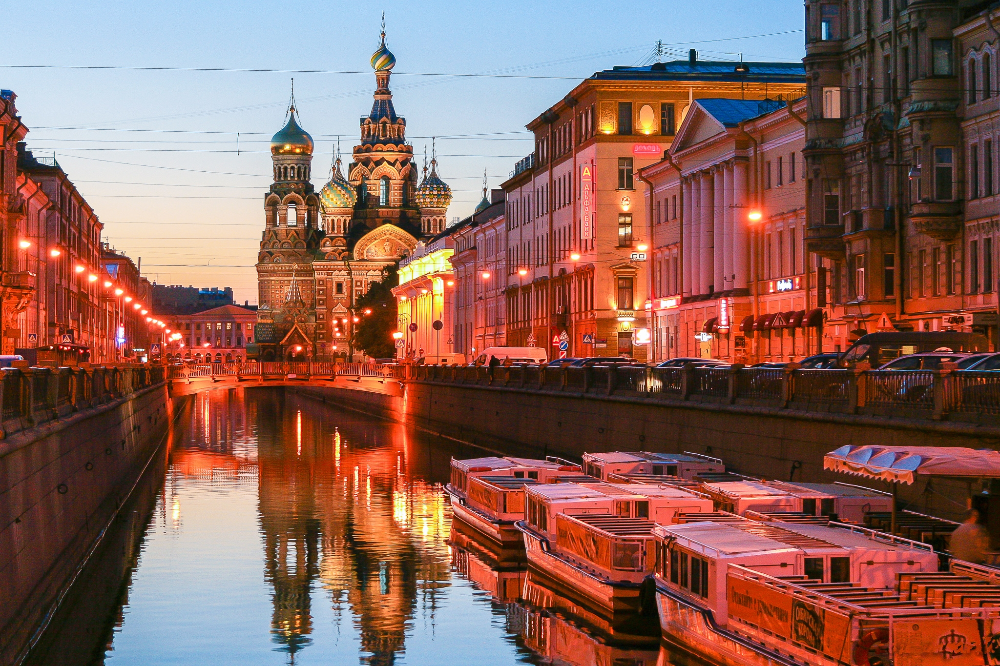

***Посмотрим сколько пропусков есть в каждом столбце***

In [7]:
df.isna().sum()

total_images                0
last_price                  0
total_area                  0
first_day_exposition        0
rooms                       0
ceiling_height           9195
floors_total               86
living_area              1903
floor                       0
is_apartment            20924
studio                      0
open_plan                   0
kitchen_area             2278
balcony                 11519
locality_name              49
airports_nearest         5542
cityCenters_nearest      5519
parks_around3000         5518
parks_nearest           15620
ponds_around3000         5518
ponds_nearest           14589
days_exposition          3181
dtype: int64

**Проверим процентное распределение пропусков по столбцам**

In [8]:
round(df.isna().mean()*100,2)

total_images             0.00
last_price               0.00
total_area               0.00
first_day_exposition     0.00
rooms                    0.00
ceiling_height          38.80
floors_total             0.36
living_area              8.03
floor                    0.00
is_apartment            88.29
studio                   0.00
open_plan                0.00
kitchen_area             9.61
balcony                 48.61
locality_name            0.21
airports_nearest        23.38
cityCenters_nearest     23.29
parks_around3000        23.28
parks_nearest           65.91
ponds_around3000        23.28
ponds_nearest           61.56
days_exposition         13.42
dtype: float64

In [9]:
# check
# пропущенные значения бары

def pass_value_barh(df):
    try:
        (
            (df.isna().mean()*100)
            .to_frame()
            .rename(columns = {0:'space'})
            .query('space > 0')
            .sort_values(by = 'space', ascending = True)
            .plot(kind= 'barh', figsize=(19,6), rot = -5, legend = False, fontsize = 16)
            .set_title('Пример' + "\n", fontsize = 22, color = 'SteelBlue')    
        );    
    except:
        print('пропусков не осталось :) ')

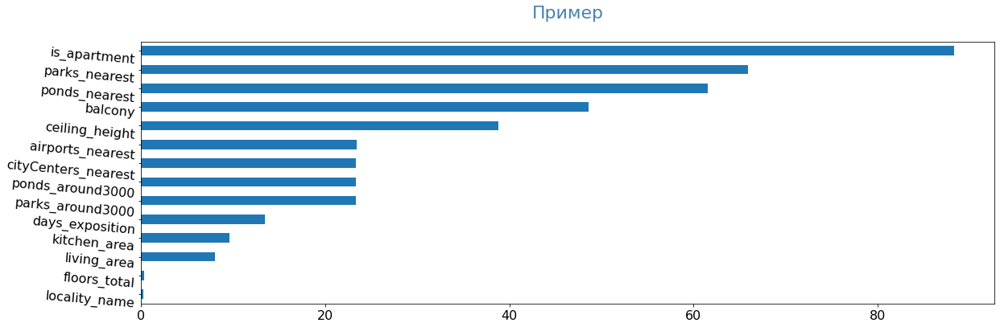

In [10]:
pass_value_barh(df)

**Заменим пропуски нулевыми значениями в столбцах, в которых логично заменить пропуски на 0**

Логика замены в том, что если продавец не указал что-то в столбце, то, скорее всего, в его квартире или рядом с ней этого нет.

In [11]:
df['balcony'] = df['balcony'].fillna(0)
df['parks_around3000'] = df['parks_around3000'].fillna(0)
df['ponds_around3000'] = df['ponds_around3000'].fillna(0)

***проверим теорию о том, что если в растоянии до парка нет значений - значит нет и самого парка***

посмотрим есть ли такие случаи, что количество парков не равно 0, а расстояние до них будет показываться как 0 после замены пустых значений

In [12]:
unique_parks_nearest = df.query('parks_around3000 == 0.0 and not(parks_nearest.isna())')
unique_parks_nearest['parks_nearest'].unique()

array([3064., 3190., 3013.])

Такие значения есть, но расстояния до парков больше 3000 метров, значит в области 3000 метров парков нет, и мы можем все пропуски заменить на 0, проверим так же водоемы

In [13]:
unique_ponds_nearest = df.query('ponds_around3000 == 0.0 and not(ponds_nearest.isna())')
unique_ponds_nearest['ponds_nearest'].unique()

array([], dtype=float64)

Теперь можем заменить и пропуски в растояниях до парков и водоемов

In [14]:
df['parks_nearest'] = df['parks_nearest'].fillna(0)
df['ponds_nearest'] = df['ponds_nearest'].fillna(0)

Заменим пропуски в столбце `is_apartment` на "False", предположительно продавец не указал это, потому что этого нет, а так как тип данных логический - на ноль заменить мы не сможем

In [15]:
df['is_apartment'] = df['is_apartment'].fillna(False)

***Проверим пропуски в `days_exposition`, возможно, эти пропуски означают, что жилплощадь еще не продана, не будем заменять на нули или медианные значения***

***Нулевых значений в столбце нет, возможно это свежие обьявления***

In [16]:
nul_day = 0 in df['days_exposition'].unique()
nul_day

False

Обработаем столбец `ceiling_height` - заменим пропуски медианными значениями для каждого района, но сначала переведем размеры потолков в единую систему счисления, гистограмма показала выбросы, которые возможны в результате того, что одни продавцы указывали высоту с запятой, а другие нет

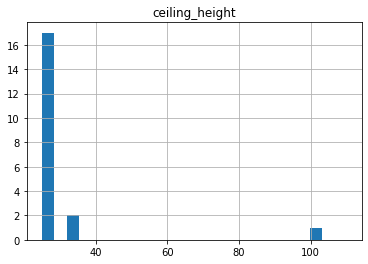

In [17]:
df.hist('ceiling_height', bins=25, range=(25,110))
plt.show()

Будем считать, что в Питере не продаются дворцы с 10 метровыми потолками, и приведем значения больше 10 метров в формат счисления в метрах с запятой

In [18]:
df.loc[df['ceiling_height'] > 15, 'ceiling_height'] = df['ceiling_height'] / 10

Проверим слишком низкие потолки

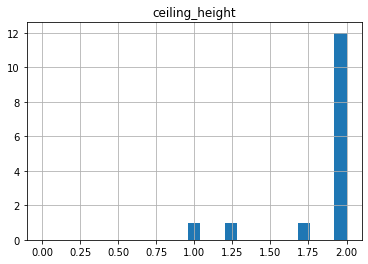

In [19]:
df.hist('ceiling_height', bins=25, range=(0,2))
plt.show()

Заменим их средним, если конечно это не нора под земллей, в которой жил да был хоббит

In [20]:
df.loc[df['ceiling_height'] < 2, 'ceiling_height'] = round(df['ceiling_height'].mean(), 2)
df.loc[df['ceiling_height'] >10, 'ceiling_height'] = round(df['ceiling_height'].mean(), 2)

Проверим дома с высокими потолками и сравним цены на них (как же много проверок...)

In [21]:
df.loc[df['ceiling_height']>5,['last_price','ceiling_height']]

,last_price,ceiling_height
464,66571000.0,5.2
1026,155000000.0,5.3
1388,59800000.0,5.6
3474,1400000.0,8.0
5863,5650000.0,8.3
7578,38000000.0,5.5
12628,3900000.0,5.3
15743,5600000.0,8.0
17442,5350000.0,8.0
20264,119000000.0,6.0


Что-то похоже на замки по ценам, а что-то нет, не решусь тут что-либо менять, мы итак из-за 2 домов столько кода написали

Заменим все пропуски на медианные значения, не оставлять же потолки слипшиеся с полом

In [22]:
df['ceiling_height'] = df['ceiling_height'].fillna(round(df['ceiling_height'].mean(), 2))

Заменим пропуски в столбце `living_area`, либо это квартиры студии без комнат, либо продавец не указал жилые метры

Умножим общую площадь на средний процент, который занимает жилая площадь

In [23]:
#df['living_area'] = df['living_area'].fillna(df['total_area']*(df['living_area'] / df['total_area']).mean())

Поступим так же с площадью кухни

In [24]:
#df['kitchen_area'] = df['kitchen_area'].fillna(df['total_area']*(df['kitchen_area'] / df['total_area']).mean())

In [25]:
df.query('total_area*0.9 <= (living_area + kitchen_area)')

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
41,16,7900000.0,74.0,2016-05-04T00:00:00,3,2.73,14.0,59.0,8,False,...,12.0,5.0,Санкт-Петербург,37715.0,12612.0,1.0,725.0,1.0,759.0,179.0
171,6,3800000.0,49.0,2019-02-22T00:00:00,2,2.50,9.0,38.0,8,False,...,10.0,1.0,посёлок Шушары,18471.0,24272.0,0.0,0.0,0.0,0.0,11.0
184,7,2600000.0,30.2,2018-02-14T00:00:00,1,2.65,9.0,26.1,5,False,...,6.2,0.0,Санкт-Петербург,13952.0,15031.0,0.0,0.0,1.0,824.0,12.0
220,8,3890000.0,37.0,2018-07-09T00:00:00,1,2.50,25.0,28.0,6,False,...,9.0,0.0,Санкт-Петербург,25408.0,16166.0,0.0,0.0,0.0,0.0,28.0
319,19,4850000.0,59.7,2015-03-19T00:00:00,3,2.50,5.0,47.4,4,False,...,6.4,1.0,Санкт-Петербург,43095.0,15599.0,0.0,0.0,0.0,0.0,974.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23216,15,10150000.0,114.0,2015-01-21T00:00:00,4,2.73,5.0,90.2,4,False,...,16.0,0.0,Санкт-Петербург,26259.0,4961.0,0.0,0.0,2.0,838.0,1052.0
23297,10,1850000.0,48.2,2019-03-13T00:00:00,2,2.73,5.0,42.2,2,False,...,6.0,1.0,Высоцк,NaN,NaN,0.0,0.0,0.0,0.0,45.0
23328,12,4299000.0,54.0,2016-11-25T00:00:00,2,2.73,14.0,40.0,8,False,...,10.0,0.0,Колпино,25612.0,31399.0,0.0,0.0,0.0,0.0,343.0
23521,13,8500000.0,65.0,2018-11-01T00:00:00,2,2.73,4.0,44.0,2,False,...,15.3,0.0,Санкт-Петербург,22276.0,3996.0,1.0,627.0,0.0,0.0,NaN


***Удалим строки, пропуски в которых составляют меньше процента, и значения которых мы не можем заменить так, чтобы это помогло решить бизнес задачу***

In [26]:
df.dropna(subset=['locality_name'], inplace=True)
df.dropna(subset=['floors_total'], inplace=True)

Растояния до аэропорта и центра города трудно заменить на медианные или срадние значения, несмотря на то, что пропуски составляют 23% оставим их как есть.

***Исправим типы данных в столбцах***

Выведем типы данных

In [27]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23565 entries, 0 to 23698
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   total_images          23565 non-null  int64  
 1   last_price            23565 non-null  float64
 2   total_area            23565 non-null  float64
 3   first_day_exposition  23565 non-null  object 
 4   rooms                 23565 non-null  int64  
 5   ceiling_height        23565 non-null  float64
 6   floors_total          23565 non-null  float64
 7   living_area           21700 non-null  float64
 8   floor                 23565 non-null  int64  
 9   is_apartment          23565 non-null  bool   
 10  studio                23565 non-null  bool   
 11  open_plan             23565 non-null  bool   
 12  kitchen_area          21343 non-null  float64
 13  balcony               23565 non-null  float64
 14  locality_name         23565 non-null  object 
 15  airports_nearest   

***Заменим тип данных столбца даты с object на datetype***

In [28]:
df['first_day_exposition'] = pd.to_datetime(df['first_day_exposition'], format='%Y-%m-%dT%H:%M:%S')

Заменим типы данных на целочисленные там, где не может быть дробных значений

In [29]:
columns_list = ['parks_around3000', 'ponds_around3000', 'floors_total', 'balcony']

for column in columns_list:
    df[column] = df[column].astype('int')


***Изучим уникальные значения в столбце с названиями и устраните неявные дубликаты.***



In [30]:
df['locality_name'].unique()

array(['Санкт-Петербург', 'посёлок Шушары', 'городской посёлок Янино-1',
       'посёлок Парголово', 'посёлок Мурино', 'Ломоносов', 'Сертолово',
       'Петергоф', 'Пушкин', 'деревня Кудрово', 'Коммунар', 'Колпино',
       'поселок городского типа Красный Бор', 'Гатчина', 'поселок Мурино',
       'деревня Фёдоровское', 'Выборг', 'Кронштадт', 'Кировск',
       'деревня Новое Девяткино', 'посёлок Металлострой',
       'посёлок городского типа Лебяжье',
       'посёлок городского типа Сиверский', 'поселок Молодцово',
       'поселок городского типа Кузьмоловский',
       'садовое товарищество Новая Ропша', 'Павловск',
       'деревня Пикколово', 'Всеволожск', 'Волхов', 'Кингисепп',
       'Приозерск', 'Сестрорецк', 'деревня Куттузи', 'посёлок Аннино',
       'поселок городского типа Ефимовский', 'посёлок Плодовое',
       'деревня Заклинье', 'поселок Торковичи', 'поселок Первомайское',
       'Красное Село', 'посёлок Понтонный', 'Сясьстрой', 'деревня Старая',
       'деревня Лесколово', '

In [31]:
#количество уникальных значений
len(df['locality_name'].unique())

364

Заменим все, что сможем

In [32]:
df['locality_name'] = df['locality_name'].str.replace('поселок','посёлок')
df['locality_name'] = df['locality_name'].str.replace('посёлок городского типа','посёлок')
df['locality_name'] = df['locality_name'].str.replace('поселок городского типа','посёлок')
df['locality_name'] = df['locality_name'].str.replace('городской посёлок','посёлок')
df['locality_name'] = df['locality_name'].str.replace('посёлок при железнодорожной станции','посёлок')
df['locality_name'] = df['locality_name'].str.replace('поселок городского типа','посёлок')
df['locality_name'] = df['locality_name'].str.replace('деревня','посёлок')
df['locality_name'] = df['locality_name'].str.replace('садовое товарищество','посёлок')
df['locality_name'] = df['locality_name'].str.replace('село','посёлок')
df['locality_name'] = df['locality_name'].str.replace('коттеджный посёлок','посёлок')

Еще раз взглянем на количество уникальных значений

In [33]:
len(df['locality_name'].unique())

312

*проверим явыне дубликаты*

In [34]:
df.duplicated().sum()

0

*Приведем все заголовки к нужному стилю*

In [35]:
df = df.rename(
    columns={
        'cityCenters_nearest':'city_centers_nearest',
        'parks_around3000':'parks_around_3000',
        'ponds_around3000':'ponds_around_3000'
    }
)

***C помощью вилки и смекалки мы смогли очистить датасет от выбросов, пропусков и повторов***

In [36]:
# check

data = df.copy()

In [37]:
# check

# Показатели о кол-ве объявлений в датасете, минимальных и максимальных значениях 
# в выбранных параметрах о продаже квартир
# сырые данные

(
    data[['rooms', 'total_area', 'ceiling_height', 'days_exposition', 'last_price', 'living_area',  'kitchen_area',
          'floor', 'floors_total']]
    .apply (['count', 'min', 'max'])   
    .style.format("{:,.2f}")
)

,rooms,total_area,ceiling_height,days_exposition,last_price,living_area,kitchen_area,floor,floors_total
count,"23,565.00","23,565.00","23,565.00","20,394.00","23,565.00","21,700.00","21,343.00","23,565.00","23,565.00"
min,0.00,12.00,2.00,1.00,"12,190.00",2.00,1.30,1.00,1.00
max,19.00,900.00,10.00,"1,580.00","763,000,000.00",409.70,112.00,33.00,60.00


<div class="alert alert-da
            nger">
<font size="4"><b>❌ Комментарий ревьюера</b></font>
    <br /> 
    <font size="3", color = "black">
<br />остались аномалии и редкости в колонках: 
        
        'rooms', 'total_area', 'ceiling_height', 'days_exposition', 'last_price', 'living_area',  'kitchen_area', 'floors_total' (не забываем про особенности почвы)

In [38]:
# check
data.rooms.value_counts().to_frame()

,rooms
1,8004
2,7897
3,5779
4,1172
5,325
0,194
6,104
7,59
8,12
9,8


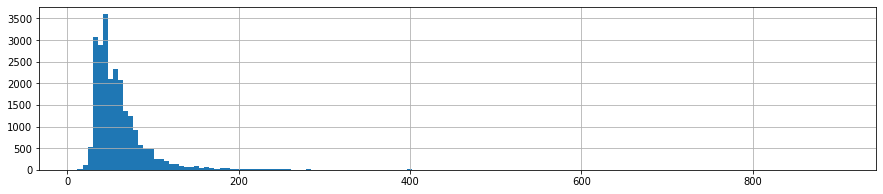

In [39]:
# check
data.total_area.hist(bins = 150, figsize = (15,3));

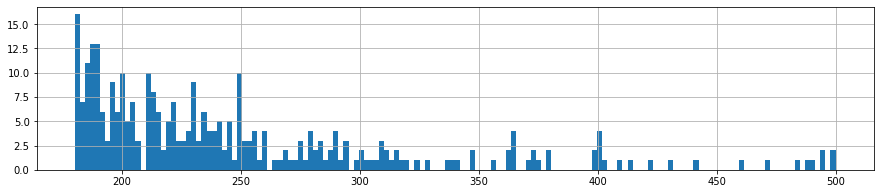

In [40]:
# check
data.total_area.hist(bins = 150, figsize = (15,3), range = (180,500));

<div class="alert alert-da
            nger">
<font size="4"><b>❌ Комментарий ревьюера</b></font>
    <br /> 
    <font size="3", color = "black">
<br />Осталось выполнить пункт 2.4 из брифа проекта

__2.4.	Найдите и устраните редкие и выбивающиеся значения.__
        
Критичный уровень потерь записей на этапе предобработки составляет 10%, оптимальный 5%

In [41]:
# check

# Значения параметров объектов недвижимости на разных квантилях

(
    data[['rooms', 'total_area', 'ceiling_height', 'days_exposition', 'last_price', 'living_area',  
        'kitchen_area', 'floor',   'floors_total']]
    .quantile([0.01, .5, .90, .9976])  
    .style.format("{:,.2f}")
)

,rooms,total_area,ceiling_height,days_exposition,last_price,living_area,kitchen_area,floor,floors_total
0.01,1.00,25.32,2.50,4.00,"1,000,000.00",13.00,5.00,1.00,2.00
0.5,2.00,52.00,2.73,95.00,"4,646,000.00",30.00,9.10,4.00,9.00
0.9,3.00,93.40,3.00,459.70,"10,900,000.00",55.00,15.89,13.00,22.00
0.9976,7.00,309.83,4.00,"1,312.06","82,000,000.00",181.66,50.00,25.00,27.00


Изменим аномалии и редкости в слобцах 'rooms', 'total_area', 'ceiling_height', 'days_exposition', 'last_price', 'living_area',  'kitchen_area', 'floors_total' (не забываем про особенности почвы)

проверим количество строк, чтобы потом оценить потери

In [42]:
df.shape

(23565, 22)

In [43]:
(
    df[['rooms', 'total_area', 'ceiling_height', 'days_exposition', 'last_price', 'living_area',  
        'kitchen_area', 'floor',   'floors_total']]
    .quantile([0.01, .5, .90, .9976])  
    .style.format("{:,.2f}")
)

,rooms,total_area,ceiling_height,days_exposition,last_price,living_area,kitchen_area,floor,floors_total
0.01,1.00,25.32,2.50,4.00,"1,000,000.00",13.00,5.00,1.00,2.00
0.5,2.00,52.00,2.73,95.00,"4,646,000.00",30.00,9.10,4.00,9.00
0.9,3.00,93.40,3.00,459.70,"10,900,000.00",55.00,15.89,13.00,22.00
0.9976,7.00,309.83,4.00,"1,312.06","82,000,000.00",181.66,50.00,25.00,27.00


поскольку распределение не нормальное, мы не можем просто удалить значение не входящие в 3 сигмы

Выведем гистаграммы для всех интересующих столбцов

array([[<AxesSubplot:title={'center':'rooms'}>]], dtype=object)

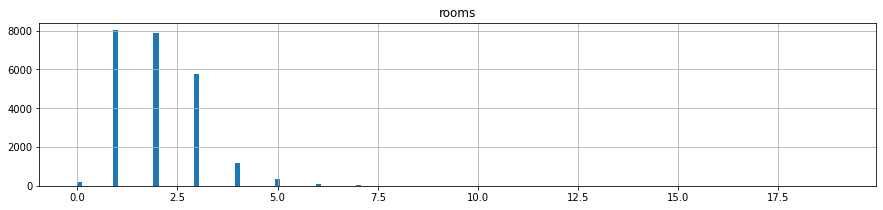

array([[<AxesSubplot:title={'center':'total_area'}>]], dtype=object)

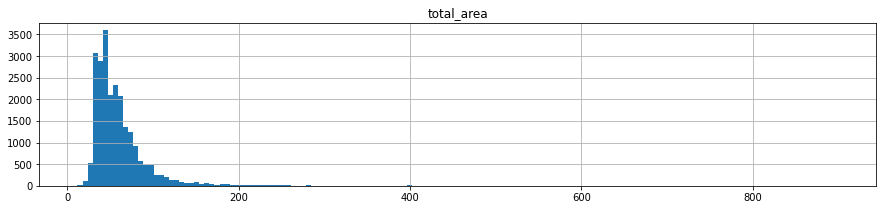

array([[<AxesSubplot:title={'center':'ceiling_height'}>]], dtype=object)

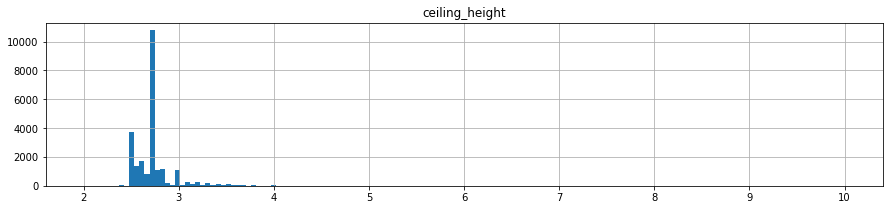

array([[<AxesSubplot:title={'center':'days_exposition'}>]], dtype=object)

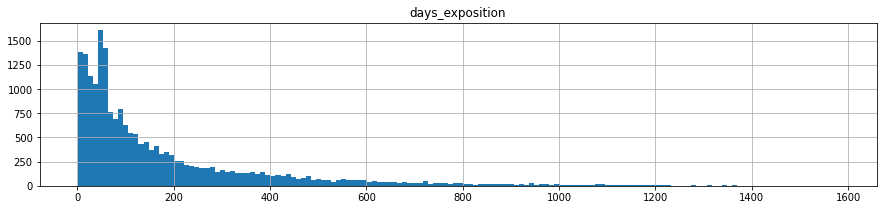

array([[<AxesSubplot:title={'center':'last_price'}>]], dtype=object)

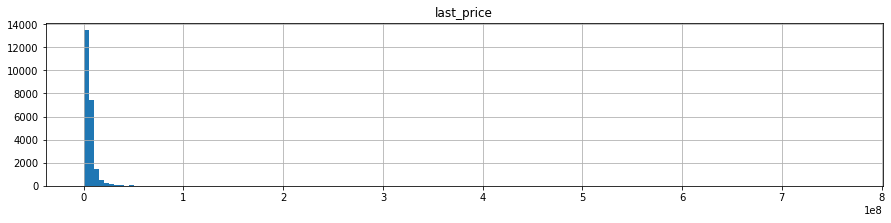

array([[<AxesSubplot:title={'center':'living_area'}>]], dtype=object)

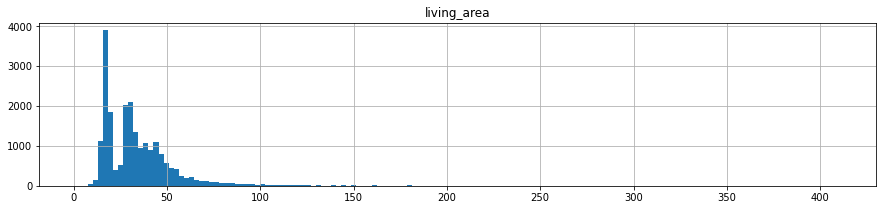

array([[<AxesSubplot:title={'center':'kitchen_area'}>]], dtype=object)

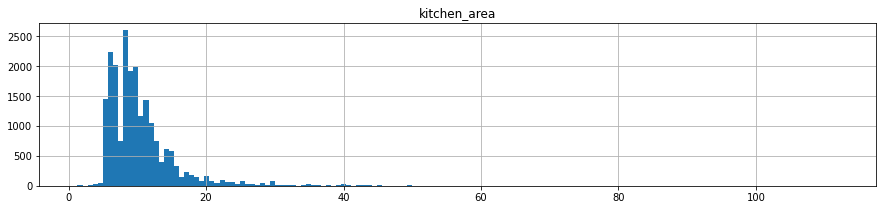

array([[<AxesSubplot:title={'center':'floors_total'}>]], dtype=object)

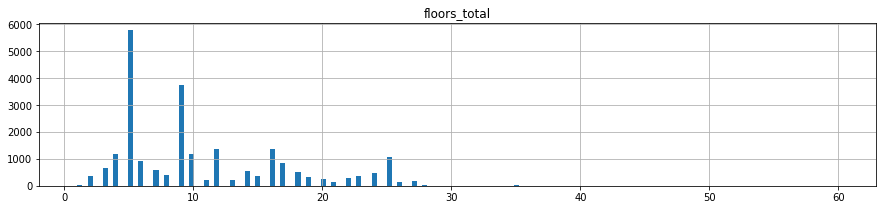

In [44]:
list_col = ['rooms', 'total_area', 'ceiling_height', 'days_exposition', 'last_price', 'living_area',  'kitchen_area', 'floors_total']

for col in list_col:
    display(df.hist(col, bins = 150, figsize = (15,3)))
    plt.show()

Удалим следующие столбцы:
- комнат больше 7
- общая площадь больше 200
- высота потолка выше 4 
- дни размещения больше 600
- цена больше 50 млн
- жилая площадь больше 100
- площадь кухни больше 30
- этажность дома больше 30

In [45]:
df = df.drop(df.index[df['rooms'] > 7])
df = df.drop(df.index[df['total_area'] > 200])
df = df.drop(df.index[df['ceiling_height'] > 4])
df = df.drop(df.index[df['days_exposition'] > 600])
df = df.drop(df.index[df['last_price'] > 50000000])
df = df.drop(df.index[df['living_area'] > 100])
df = df.drop(df.index[df['kitchen_area'] > 30])
df = df.drop(df.index[df['floors_total'] > 30])

In [46]:
df.shape

(21707, 22)

In [47]:
21707 * 100 / 23699

91.59458204987553

Было 23565 обьектов, стало 21707

Мы потеряли 8,5 %, но данные стали более однородны и пригодны для исследования

Приемлемо.

In [48]:
# check

# Показатели о кол-ве объявлений в датасете, минимальных и максимальных значениях 
# в выбранных параметрах о продаже квартир
# сырые данные

(
    df[['rooms', 'total_area', 'ceiling_height', 'days_exposition', 'last_price', 'living_area',  'kitchen_area',
          'floor', 'floors_total']]
    .apply (['count', 'min', 'max'])   
    .style.format("{:,.2f}")
)

,rooms,total_area,ceiling_height,days_exposition,last_price,living_area,kitchen_area,floor,floors_total
count,"21,707.00","21,707.00","21,707.00","18,727.00","21,707.00","19,956.00","19,607.00","21,707.00","21,707.00"
min,0.00,12.00,2.00,1.00,"430,000.00",2.00,1.30,1.00,1.00
max,7.00,199.20,4.00,600.00,"50,000,000.00",100.00,30.00,27.00,29.00


### Посчитайте и добавьте в таблицу новые столбцы

>*Питер — это:*

>*— Смотри, какой красивый дом!*

>*— Какой?*

>*— Любой.*

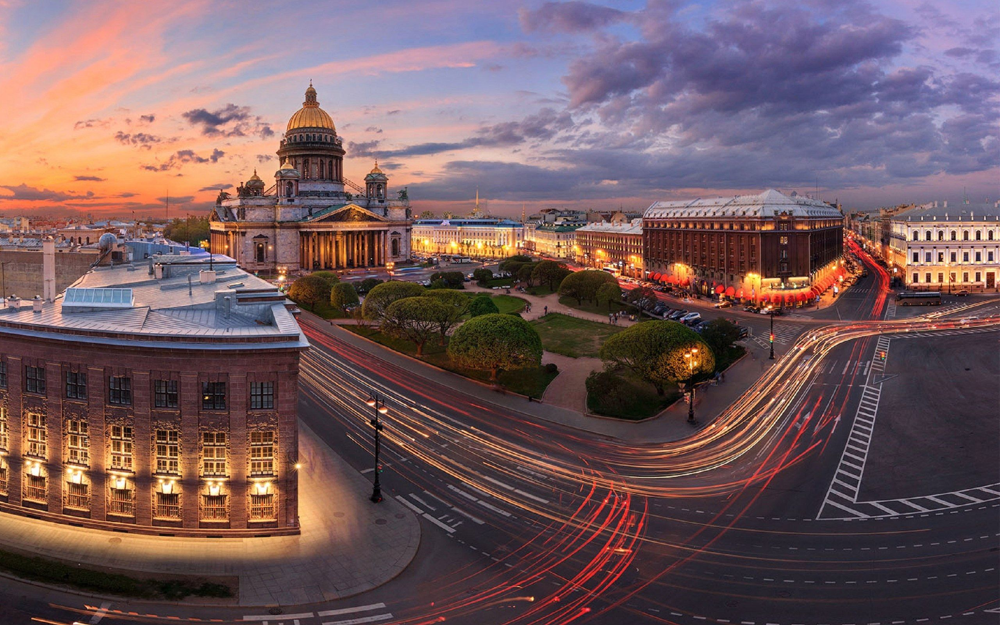

***Добавим в таблицу новые столбцы со следующими параметрами***

Цена одного квадратного метра

In [49]:
df['price_per_sqm'] = round(df['last_price'] / df['total_area'], 2)

день недели публикации объявления (0 — понедельник, 1 — вторник и так далее)

In [50]:
df['weekday_exposition'] = df['first_day_exposition'].dt.weekday

месяц публикации объявления

In [51]:
df['month_exposition'] = df['first_day_exposition'].dt.month

год публикации объявления

In [52]:
df['year_exposition'] = df['first_day_exposition'].dt.year

тип этажа квартиры (значения — «‎первый», «последний», «другой»)

In [53]:
df.loc[df['floor'] == 1, 'floor_category'] = 'первый'
df.loc[df['floor'] == df['floors_total'], 'floor_category'] = 'последний'
df.loc[df['floor_category'].isna(), 'floor_category'] = 'другой'

расстояние до центра города в километрах (переведите из м в км и округлите до целых значений)

In [54]:
df['city_centers_nearest_per_km'] = round(df['city_centers_nearest'] / 1000, 0)

### Проведите исследовательский анализ данных

>*Если вам будут говорить, что летней ночью в Петербурге нужно идти смотреть на мосты, — не ходите, это какая-то разводка.*

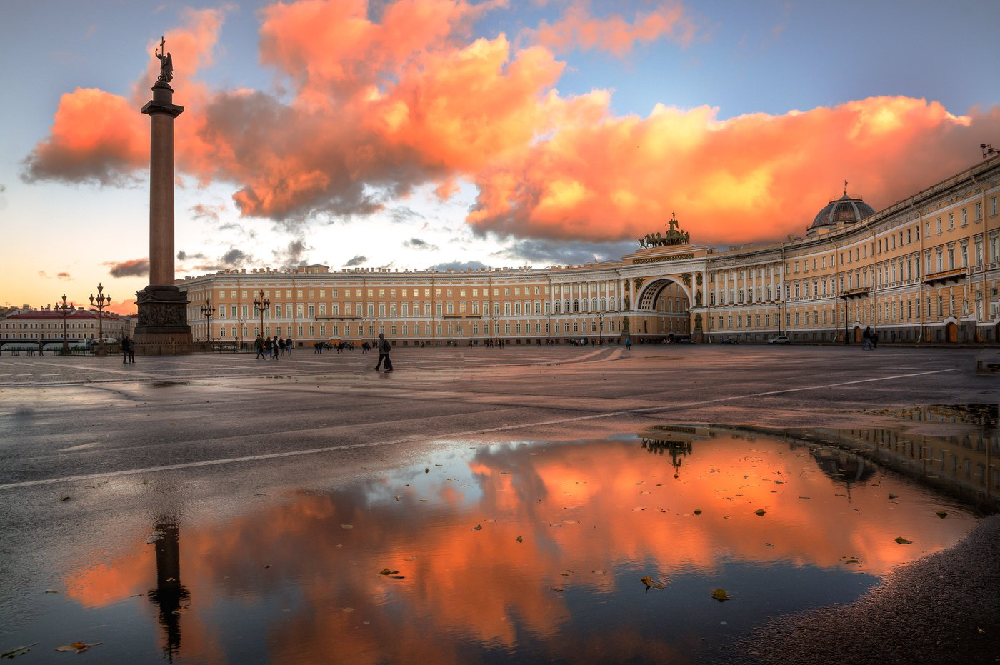

Изучите следующие параметры объектов:
- общая площадь;


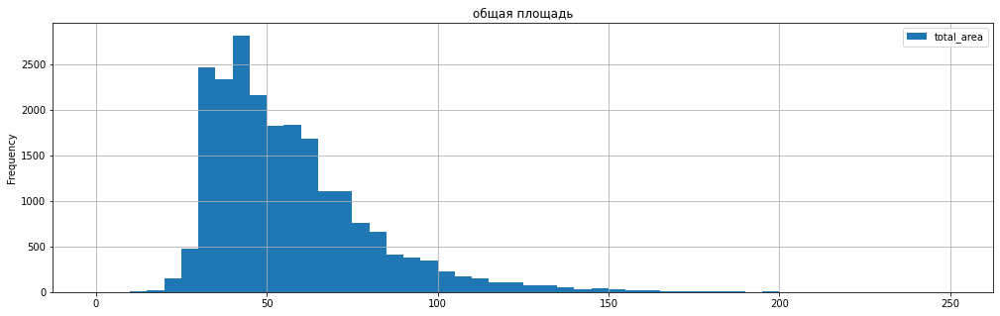

In [55]:
df.plot(y = 'total_area', kind = 'hist',title='общая площадь', bins = 50, grid=True, range = (0,250),figsize=(17,5))
plt.show()

In [56]:
df['total_area'].describe()

count    21707.000000
mean        56.136139
std         23.261479
min         12.000000
25%         39.700000
50%         50.700000
75%         66.900000
max        199.200000
Name: total_area, dtype: float64

***Вывод:***
    
Распределение Пуассона, и эта фраза тут появится еще не раз

Очень длинный хвост, максимальная площадь доходит аж до 900 квадратных метров, но мы не стали удалять эти особняки из выборки

средняя площадь  = 60 кв метров

самые скромные комнатушки 12 метров

большая часть в диапазоне от 25 до 100

- жилая площадь;

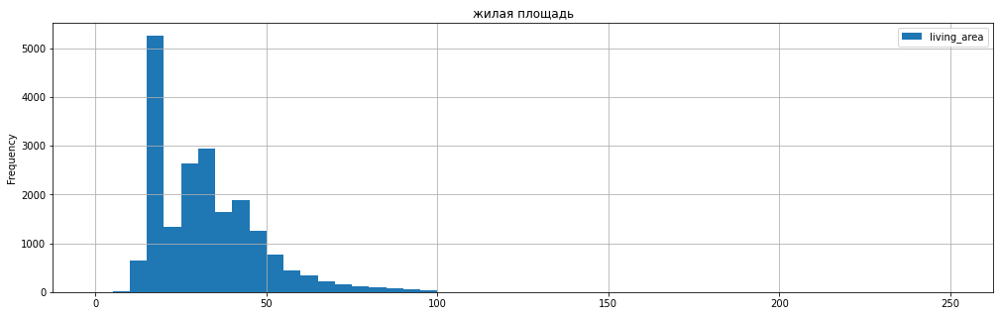

In [57]:
df.plot(y = 'living_area', kind = 'hist',title='жилая площадь', bins = 50, grid=True, range = (0,250),figsize=(17,5))
plt.show()

In [58]:
df['living_area'].describe()

count    19956.000000
mean        32.101284
std         15.288687
min          2.000000
25%         18.400000
50%         30.000000
75%         41.000000
max        100.000000
Name: living_area, dtype: float64

***Вывод:***
    
Распределение Пуассона

Повторяет распределение общей площади, возможно можно было заменять пропуски в зависимости от местности

среднее значение = 34 метра

самое большое = 409

большая часть в диапазоне от 3 до 50

- площадь кухни;

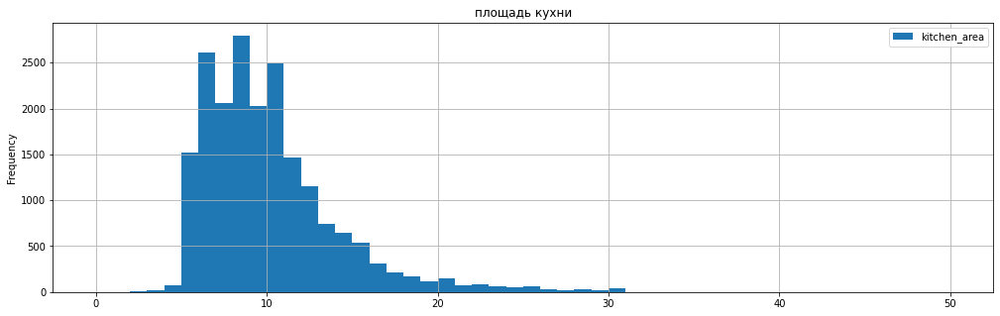

In [59]:
df.plot(y = 'kitchen_area', kind = 'hist',title='площадь кухни', bins = 50, grid=True, range = (0,50),figsize=(17,5))
plt.show()

In [60]:
df['kitchen_area'].describe()

count    19607.000000
mean         9.901154
std          3.990108
min          1.300000
25%          7.000000
50%          9.000000
75%         11.500000
max         30.000000
Name: kitchen_area, dtype: float64

***Вывод:***
    
Распределение Пуассона

тут все то же самое, взаимосвязь с предыдущими двумя графиками

среднее = 10 метров

самая большая кухня 112 метров, что звучит как выброс

минимальное значение характерно для студий

большая часть в диапазоне от 5 до 20

- цена объекта;

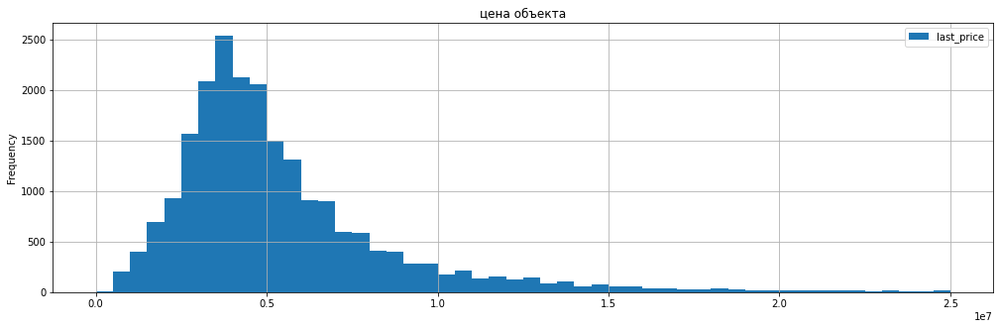

In [61]:
df.plot(y = 'last_price', kind = 'hist',title='цена объекта', bins = 50, grid=True, range = (0,25000000),figsize=(17,5))
plt.show()

In [62]:
df['last_price'].describe()

count    2.170700e+04
mean     5.564086e+06
std      4.054359e+06
min      4.300000e+05
25%      3.390000e+06
50%      4.500000e+06
75%      6.450000e+06
max      5.000000e+07
Name: last_price, dtype: float64

In [63]:
df['last_price'].median()

4500000.0

***Вывод:***
    
Распределение Пуассона

Очень длинный хвост с дорогой недвижимостью, лучше взять медиану для оценки среднего = около 4,65 миллионов

Если отбросить цены выше 10 миллионов получим нормальное распределение

- количество комнат;

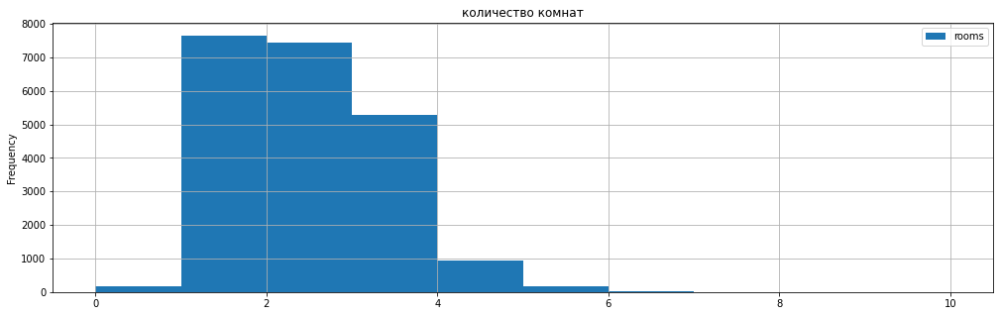

In [64]:
df.plot(y = 'rooms', kind = 'hist',title='количество комнат', bins = 10, grid=True, range = (0,10),figsize=(17,5))
plt.show()

In [65]:
df['rooms'].describe()

count    21707.000000
mean         1.990372
std          0.948333
min          0.000000
25%          1.000000
50%          2.000000
75%          3.000000
max          7.000000
Name: rooms, dtype: float64

***Вывод:***
    
Даже на таком маленьком графике - распределение Пуассона

Самые часто встречаемые - самые типичные : 1-3 комнаты

дома без комнат наверное студии

Есть особняк с 19 комнатами, интересно кто там живет?

- высота потолков;

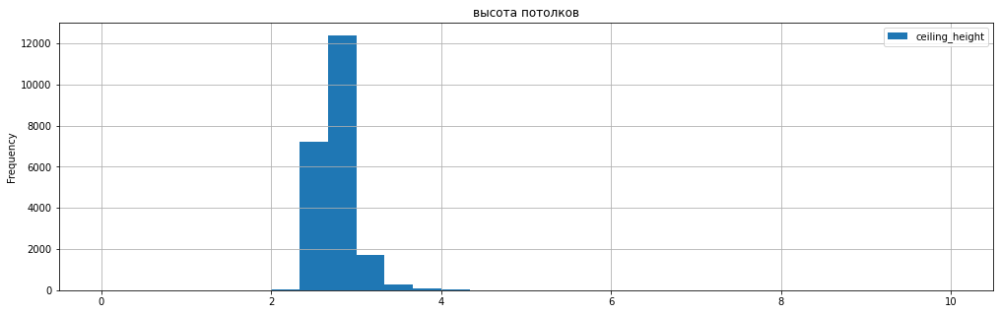

In [66]:
df.plot(y = 'ceiling_height', kind = 'hist',title='высота потолков', bins = 30, grid=True, range = (0,10),figsize=(17,5))
plt.show()

In [67]:
df['ceiling_height'].describe()

count    21707.000000
mean         2.713735
std          0.187915
min          2.000000
25%          2.600000
50%          2.730000
75%          2.730000
max          4.000000
Name: ceiling_height, dtype: float64

***Вывод:***
    
Потолки средние, потому что мы сами так и сделали

Людям комфортно - все довольны

Многое обрезали, перевели и заменили, лучше всего дать фидбек коллегам по поводу качества сбора данных

- этаж квартиры;

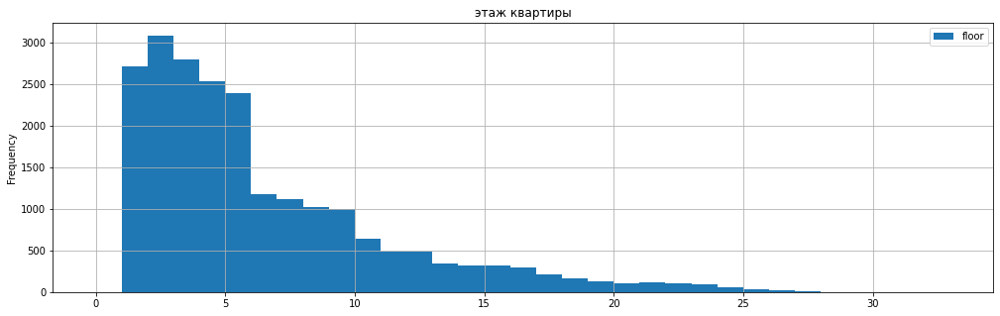

In [68]:
df.plot(y = 'floor', kind = 'hist',title='этаж квартиры', bins = 33, grid=True, range = (0,33),figsize=(17,5))
plt.show()

In [69]:
df['floor'].describe()

count    21707.000000
mean         5.897314
std          4.868378
min          1.000000
25%          2.000000
50%          4.000000
75%          8.000000
max         27.000000
Name: floor, dtype: float64

***Вывод:***
    
Распределение Пуассона

Самые продаваемы - квартиры с 1 по 5 этаж

средний уровень этажа в районе 5-6

- тип этажа квартиры («первый», «последний», «другой»);

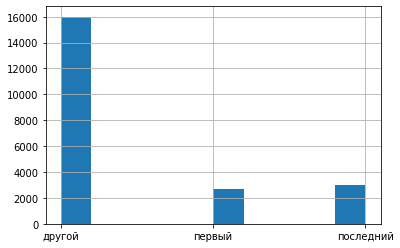

In [70]:
df['floor_category'].hist()
plt.show()

In [71]:
df['floor_category'].value_counts()

другой       15997
последний     3028
первый        2682
Name: floor_category, dtype: int64

***Вывод:***
    
>-Этаж может быть только первым и последним.

>-А как же этажи между ними???

>-Вы не понимаете, это другое ...

Как ни странно, этажей кроме первых и последних много, на последнем продают немного почаще, возможно не всем нравится подниматься на самый верх, особенно без лифта

- общее количество этажей в доме;

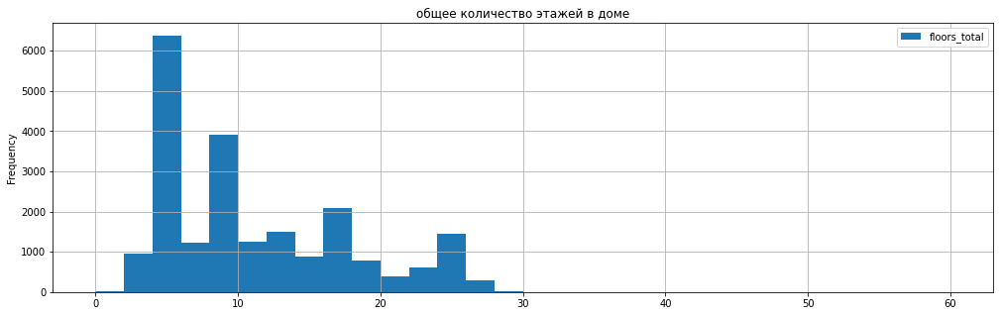

In [72]:
df.plot(
    y = 'floors_total', kind = 'hist'
    ,title='общее количество этажей в доме'
    , bins = 30, grid=True
    , range = (0,60)
    ,figsize=(17,5))
plt.show()

In [73]:
df['floors_total'].describe()

count    21707.000000
mean        10.749712
std          6.559529
min          1.000000
25%          5.000000
50%          9.000000
75%         16.000000
max         29.000000
Name: floors_total, dtype: float64

In [74]:
df['floors_total'].median()

9.0

***Вывод:***
    
Очень интересное распределение, есть несколько мод, можно сказать, что большая часть Питера однородна и состоит из пятиэтажек, очень красивых пятиэтажек, дальше часто встречаемые дома в 9 этажей, небольшие пики в 10, 12, 16 и 25 этажей, наверное это спальные районы, из которых люди по выходным ездят в красивые пятиэтажки в центр :)

Среднее значение у 10 этажа - это значит, что вторая часть питера все же состоит из высоток

Самый низкий дом - одноэтажный, соседи там точно не затопят

Самый высокий 60 этажей ... кто-то решил продать Лахта Центр

In [75]:
df[df['floors_total'] == 60]['locality_name']

Series([], Name: locality_name, dtype: object)

Кронштадт

Да, 60 этажей тут быть не может

- расстояние до центра города в метрах;

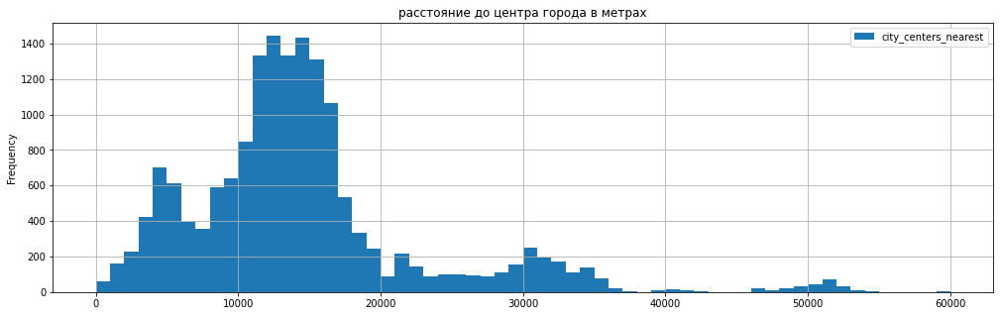

In [76]:
df.plot(y = 'city_centers_nearest', kind = 'hist',title='расстояние до центра города в метрах', bins = 60, grid=True, range = (0,60000),figsize=(17,5))
plt.show()

In [77]:
df['city_centers_nearest'].describe()

count    16479.000000
mean     14538.948359
std       8510.240740
min        208.000000
25%       9912.500000
50%      13301.000000
75%      16446.000000
max      65952.000000
Name: city_centers_nearest, dtype: float64

***Вывод:***
    
Распределение не нормальное, есть 2 вершины, в основном все жилые помещения в диапазоне от 10км до 20км, что и логично, ведь если представить круг, то чем дальше от центра, тем больше окружность, а значит больше домов можно построить, тем более многоэтажек, встречаются небольшие бугорки после 20км, 30км и 50км, скорее всего это населеные пункты, которые собрали дома

среднее = 14км

самый близкий к центру дом = 181 метр, кому-то повезло жить в эпицентре багем

самый отдаленный дом = 65км

- расстояние до ближайшего аэропорта;

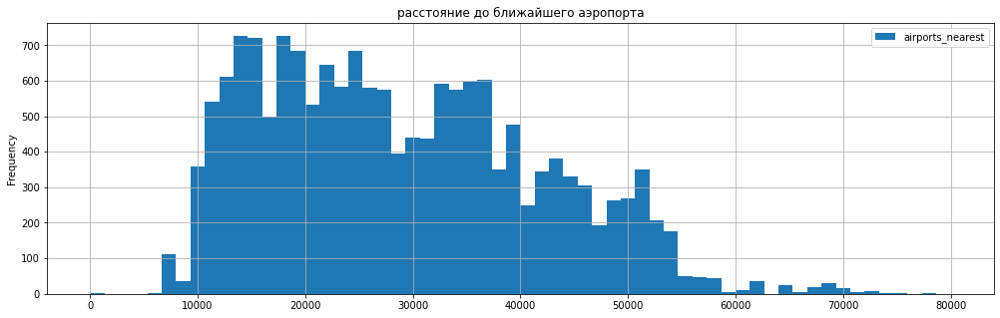

In [78]:
df.plot(y = 'airports_nearest', kind = 'hist',title='расстояние до ближайшего аэропорта', bins = 60, grid=True, range = (0,80000),figsize=(17,5))
plt.show()

In [79]:
df['airports_nearest'].describe()

count    16459.000000
mean     28933.011179
std      12823.712310
min          0.000000
25%      18357.500000
50%      27102.000000
75%      37434.000000
max      84853.000000
Name: airports_nearest, dtype: float64

***Вывод:***
    
Ближе 10км домов нет, что правильно, ведь соседство с ревущими круглосуточно самолетами не самое приятное для здоровья

Среднее растояние = 29 км
В основном дома расположены в диапозоне от 10 до 60 км и равномерно убывыют

Самый близкий дом - в 0 метрах, выходит кто-то продает аэропорт

Самый отдаленный в 85км, тут лучше заказывать такси заранее

- расстояние до ближайшего парка;

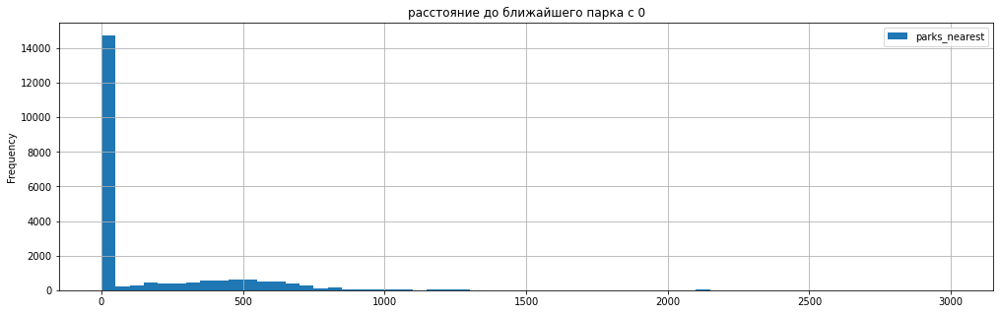

In [80]:
df.plot(y = 'parks_nearest', kind = 'hist',title='расстояние до ближайшего парка c 0', bins = 60, grid=True, range = (0,3000),figsize=(17,5))
plt.show()

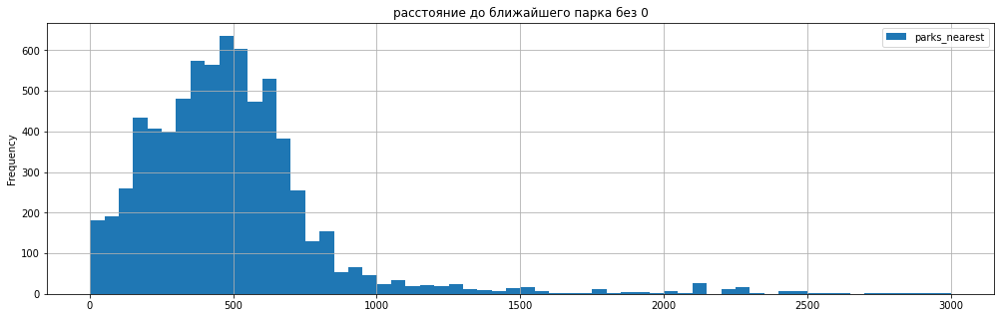

In [81]:
df.plot(y = 'parks_nearest', kind = 'hist',title='расстояние до ближайшего парка без 0', bins = 60, grid=True, range = (1,3000),figsize=(17,5))
plt.show()

In [82]:
df['parks_nearest'].describe()

count    21707.000000
mean       161.958447
std        301.622511
min          0.000000
25%          0.000000
50%          0.000000
75%        283.000000
max       3190.000000
Name: parks_nearest, dtype: float64

***Вывод:***
    
Было принято неверное решение заменить все отсутствующие значения нулями, в диапазоне 3км парков действительно нет, но ведь где-то дальше они все же есть, есть убрать все нули, которые мы сами же и поставили, то получим наблюдение - что парки на каждом шагу, в полукилометре от дома вы наверняка найдете куда выйти покормить голубей или почитать на лавочке

- день и месяц публикации объявления.

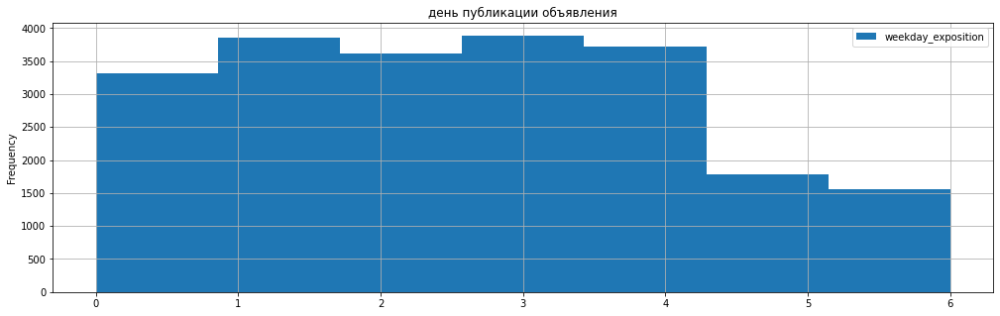

In [83]:
df.plot(y = 'weekday_exposition', kind = 'hist',title='день публикации объявления', bins = 7, grid=True,figsize=(17,5))
plt.show()

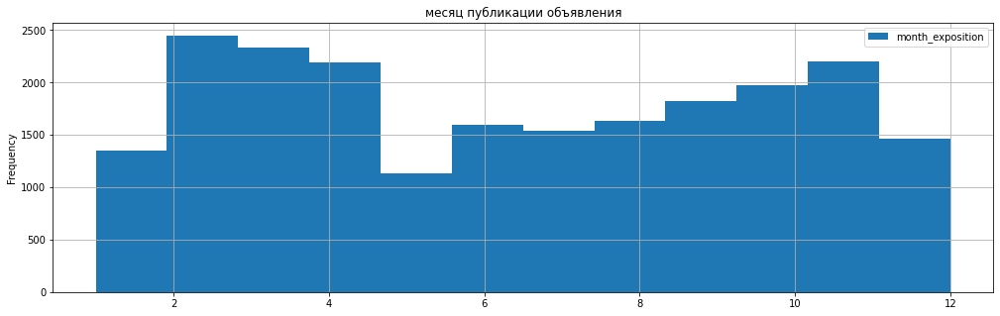

In [84]:
df.plot(y = 'month_exposition', kind = 'hist',title='месяц публикации объявления', bins = 12, grid=True,figsize=(17,5))
plt.show()

***Вывод:***
    
Распределение по дням - в течении рабочих дней распределение равномерно, немного меньше в понедельник, на выходных выставленные обьявления сильно падают. По выходным люди любят отдыхать.

Распределение по месяцам - чаще всего жилье выставляют весной, летом и зимой самые большие спады, в мае никто не работает и ничего не делает, целый месяц шаббат, в декабре и январе люди так же заняты другими делами

<div class="alert alert-success">
<font size="4", color= "seagreen"><b>✔️ Комментарий ревьюера</b></font>
    <br /> 
    <font size="3", color = "black">
<br /> Исследование параметров объектов недвижимости выполнено корректно, молодец

- Постройте отдельные гистограммы для каждого из этих параметров. Опишите все ваши наблюдения по параметрам в ячейке с типом markdown.

Изучите, как быстро продавались квартиры (столбец days_exposition). Этот параметр показывает, сколько дней было размещено каждое объявление.

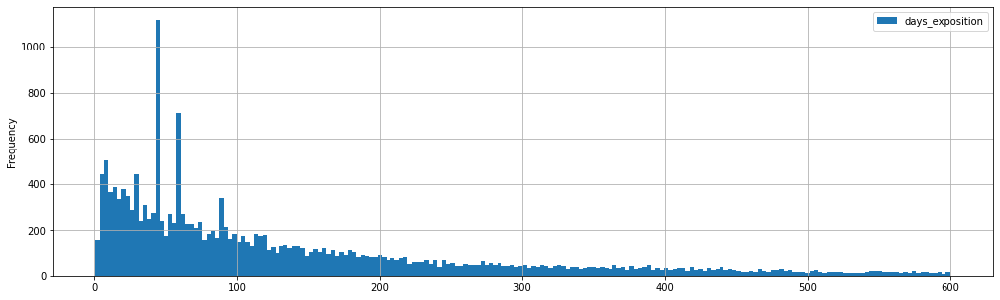

In [85]:
df.plot(y = 'days_exposition', kind = 'hist', bins = 200, grid=True,figsize=(17,5))
plt.show()

In [86]:
df['days_exposition'].describe()

count    18727.000000
mean       137.438244
std        135.872005
min          1.000000
25%         42.000000
50%         87.000000
75%        192.000000
max        600.000000
Name: days_exposition, dtype: float64

In [87]:
df['days_exposition'].median()

87.00000000000001

***вывод:***

Среднее значение времени продажи - 95 дней по медиане, и 180 по среднему

Встечаются обьекты которые не могу продать по 4 года

Но чаще всего недвижимость удастся продать в диапазоне до 2 месяцев

Быстрые продажи - в течении нескольких дней, недель, таких очень много

Необычаяно долгие 1500 дней

График постепенно скатывается с самых высоких значений, видны пики, возможно это связанно с тем, что спустя время цена опускается, чтобы быстрее найти клиента

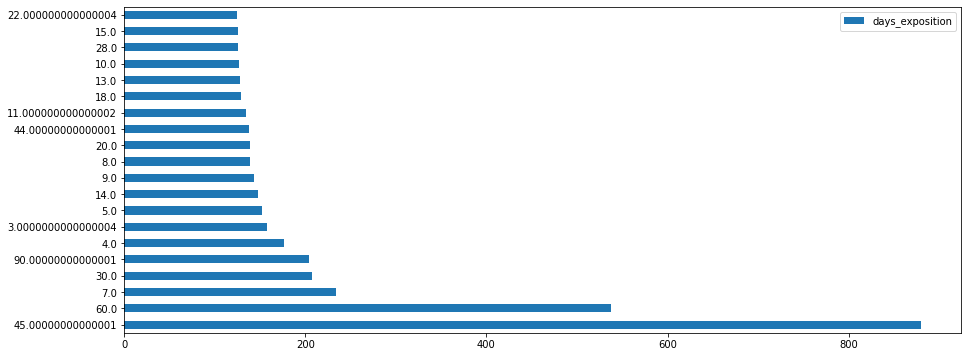

In [88]:
# check
# Моды на реальных данных

try:
    df_check = pd.read_csv('real_estate_data.csv', sep='\t') 
except:
    df_check = pd.read_csv('/datasets/real_estate_data.csv', sep = '\t')
    
df_check['days_exposition'].value_counts().to_frame().head(20).plot(kind = 'barh', figsize = (15,6), rot = 0);

***Какие факторы больше всего влияют на общую (полную) стоимость объекта?***

Изучите, зависит ли цена от:
- общей площади;

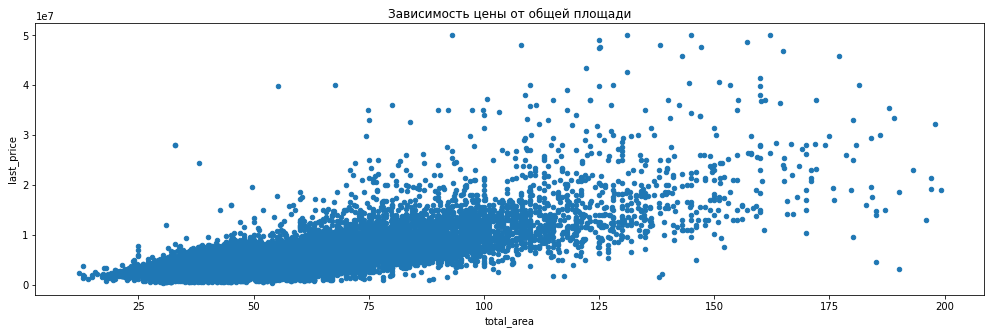

In [89]:
df.plot(x='total_area', y='last_price', kind='scatter',figsize=(17,5),title='Зависимость цены от общей площади')
plt.show()

Коэффициент корреляции от общей площади

In [90]:
round(df['total_area'].corr(df['last_price']), 2)

0.75

Коэффициент корреляции равный 0,65 показывает наличие зависимости цены от общей площади

- жилой площади;

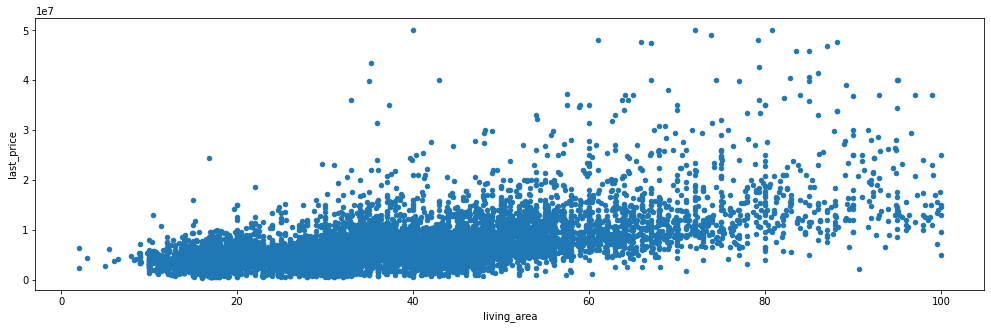

In [91]:
df.plot(x='living_area', y='last_price', kind='scatter', figsize=(17,5))
plt.show()

Коэффициент корреляции цены от жилой площади

In [92]:
round(df['living_area'].corr(df['last_price']), 2)

0.63

Зависимость есть, после 100 кв м разброс увеличивается, зависимость выражена сильнее для площади до 80 кв м

- площади кухни;

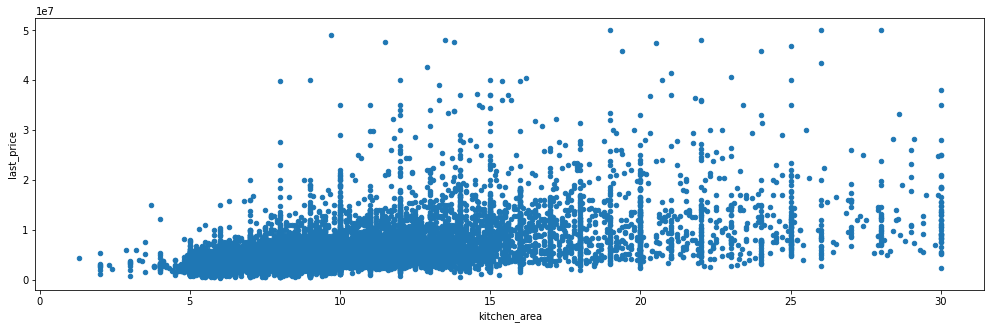

In [93]:
df.plot(x='kitchen_area', y='last_price', kind='scatter', figsize=(17,5))
plt.show()

Коэффициент корреляции цены от площади кухни

In [94]:
round(df['kitchen_area'].corr(df['last_price']), 2)

0.54

Коэффициент корреляции - 0.52, зависимость есть, разброс увеличивается после 3 кв м

- количества комнат;

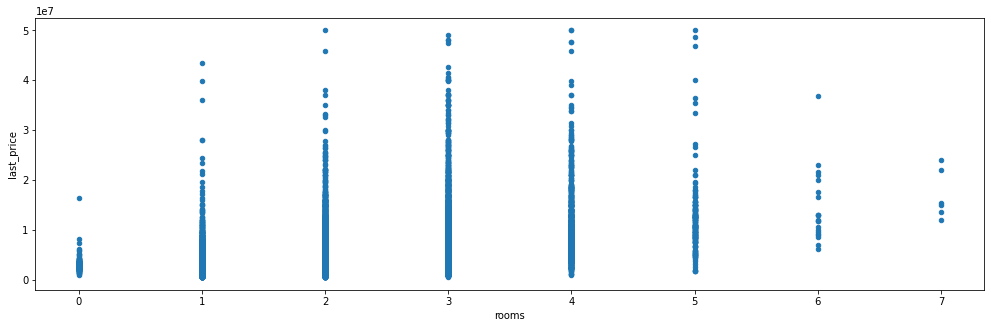

In [95]:
df.plot(x='rooms', y='last_price', kind='scatter', figsize=(17,5))
plt.show()

Коэффициент корреляции цены от количества комнат

In [96]:
round(df['rooms'].corr(df['last_price']), 2)

0.44

Коэффициент корреляции 0.36, зависимость есть, но не такая сильная как от площади

- этажа, на котором расположена квартира (первый, последний, другой);

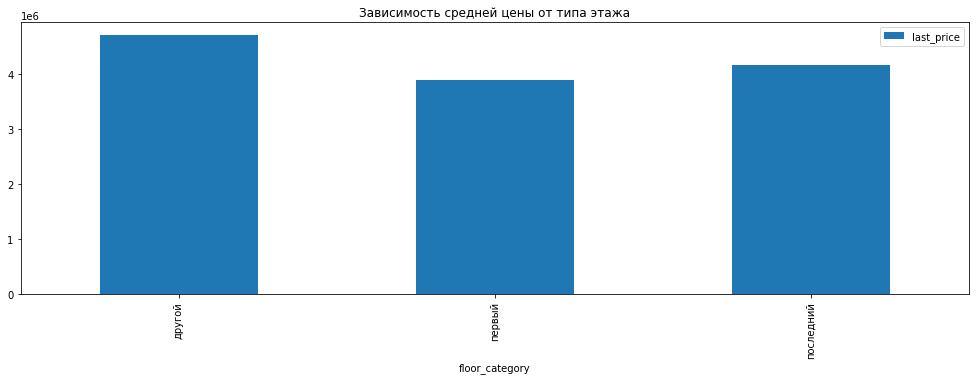

In [97]:
df.pivot_table(index='floor_category', values='last_price', aggfunc=('median')).plot(style='-',title='Зависимость средней цены от типа этажа', figsize=(17,5), kind='bar')
plt.show()

Коэффициент корреляции цены от этажа

In [98]:
df.pivot_table(index='floor_category', values='last_price', aggfunc='median')

,last_price
floor_category,
другой,4700000.0
первый,3890000.0
последний,4150000.0


Дешевле стоят первые этажи, этажи между первым и последним самые дорогие, цена последнего посередине между первыми и другими

- даты размещения (день недели, месяц, год).

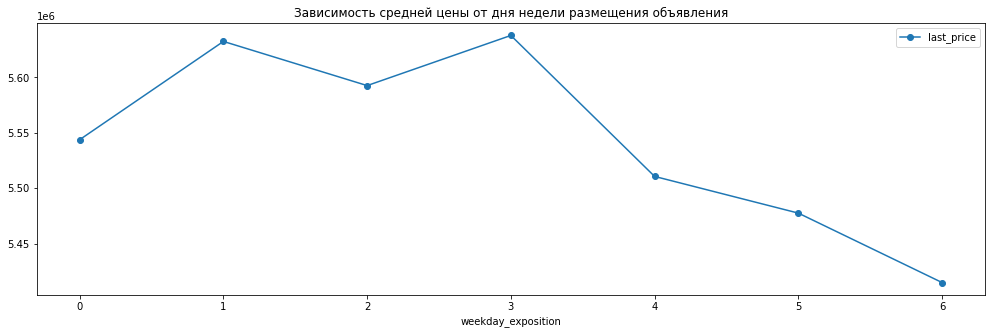

In [99]:
df.pivot_table(index='weekday_exposition', values='last_price').plot(style='o-',title='Зависимость средней цены от дня недели размещения объявления', figsize=(17,5))
plt.show()

Коэффициент корреляции цены от дня недели размещения объявления

In [100]:
round(df['weekday_exposition'].corr(df['last_price']),2)

-0.01

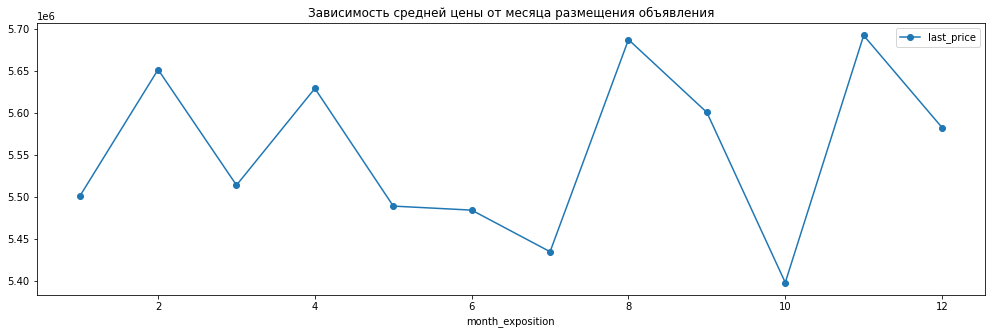

In [101]:
df.pivot_table(index='month_exposition', values='last_price').plot(style='o-',title='Зависимость средней цены от месяца размещения объявления', figsize=(17,5))
plt.show()

Коэффициент корреляции цены от месяца размещения объявления

In [102]:
round(df['month_exposition'].corr(df['last_price']), 2)

0.0

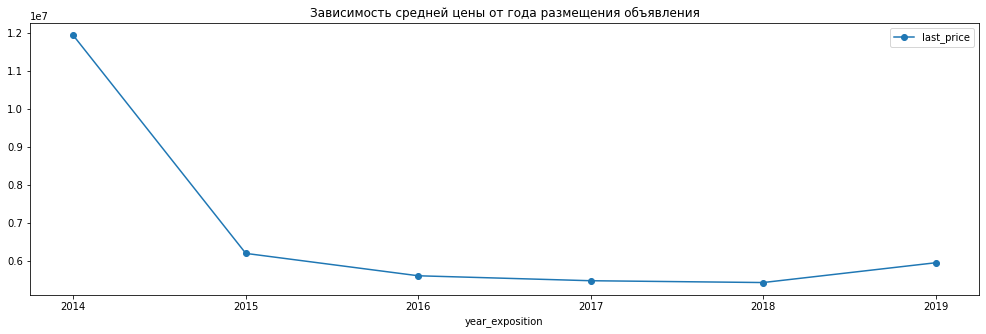

In [103]:
df.pivot_table(index='year_exposition', values='last_price').plot(style='o-',title='Зависимость средней цены от года размещения объявления', figsize=(17,5))
plt.show()

Коэффициент корреляции цены от года размещения объявления

In [104]:
round(df['year_exposition'].corr(df['last_price']), 2)

-0.01

Ни от года, ни от месяца, ни от дня недели зависимости с ценой нет, коэффециент корреляции равен около нулю

Посчитайте среднюю цену одного квадратного метра в 10 населённых пунктах с наибольшим числом объявлений. Выделите населённые пункты с самой высокой и низкой стоимостью квадратного метра. Эти данные можно найти по имени в столбце `locality_name`

In [105]:
round(df.pivot_table(index='locality_name', values='price_per_sqm', aggfunc=['mean', 'median', 'count']),2)\
.sort_values(('count', 'price_per_sqm'), ascending=False)\
.head(10)\
.sort_values(('median', 'price_per_sqm'), ascending=False)

,mean,median,count
,price_per_sqm,price_per_sqm,price_per_sqm
locality_name,,,
Санкт-Петербург,111102.56,104072.40,14195
Пушкин,102501.92,99650.35,339
посёлок Кудрово,92781.95,92089.73,275
посёлок Парголово,90166.96,91428.57,317
посёлок Мурино,85760.55,86075.95,531
посёлок Шушары,78557.50,76876.18,424
Колпино,75207.27,74421.54,328
Гатчина,68950.64,67796.61,287


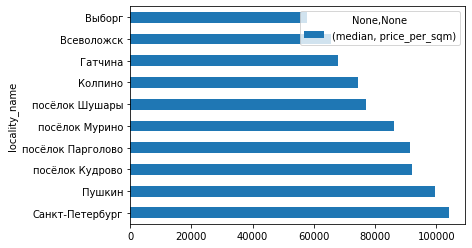

In [106]:
df.pivot_table(index='locality_name', values='price_per_sqm', aggfunc=['mean', 'median', 'count'])\
.sort_values(('count', 'price_per_sqm'), ascending=False)\
.head(10)\
.sort_values(('median', 'price_per_sqm'), ascending=False)\
.plot(y=('median', 'price_per_sqm'),kind='barh')
plt.show()

***вывод:***

Дороже всего квадратный метр стоит в Санкт-Петербурге, медианная цена одного квадратного метра в нем 105 тысяч

Почти в 2 раза дешевле жилплощадь в Выборге - последнем 10 представителе самых дорогих помещений, медианное значение там 58 тысяч

Ранее вы посчитали расстояние до центра в километрах. Теперь выделите квартиры в Санкт-Петербурге с помощью столбца `locality_name` и вычислите среднюю цену каждого километра. Опишите, как стоимость объектов зависит от расстояния до центра города.

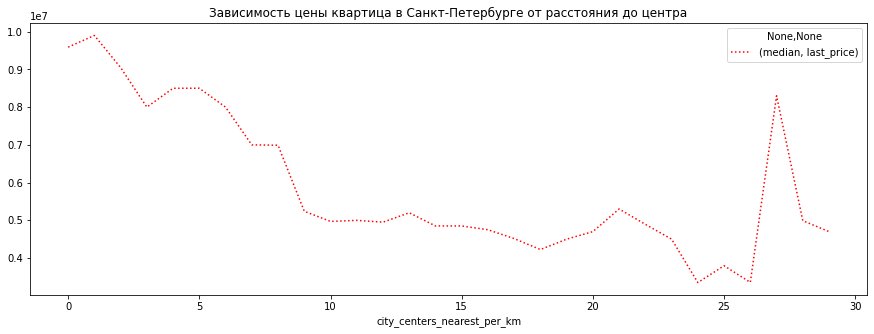

In [107]:
df.query('locality_name == "Санкт-Петербург"')\
.pivot_table(index='city_centers_nearest_per_km', values=['last_price'], aggfunc=['median'])\
.plot(style='r:',title='Зависимость цены квартица в Санкт-Петербурге от расстояния до центра', figsize=(15,5))
plt.show()

Цена снижается по мере удаления от центра, есть подьемы стоимости в районе 5 км, 20 км, и сильный пик в районе 27 км, наверное это какой-то населенный пункт, самые дорогие квартиры в центре, и падают в цене почти в 2 раза по мере удаления до 3 км, и в 3-4 раза на расстоянии до 15 км

### Общий вывод

>*Интересно, сколько детей родилось в Питере от того, что "мосты уже развели, ночуй у меня"?*

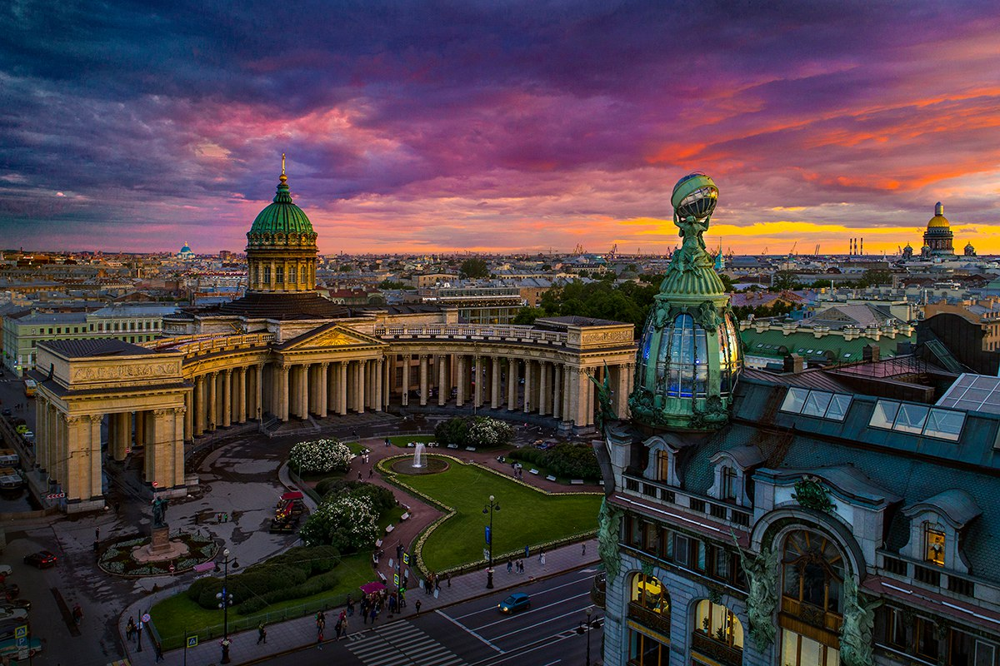

Вот и подошло к концу наше исследование, а значит нам пора прощаться. В конце хочется еще раз подвести итоги всей проделанной работы.

Мы получили данные о продажи квартир в Санкт-Петербурге и его окресностях, изучили общие показатели данных, затем очистили данные от пропусков там, где это логично, заменив пропуски нулевыми значениями и медианами коректных значений где это возможно, поменяли типы данных в столбцах с целочисленными значениями и датами, создали дополнительные столбцы с ценами за квадратный метр, днем, месяцем и годом публикации, удаленностью от центра в км и после этого провели тщательный анализ.

В ходе анализа мы выяснили:
- Цена на недвижимость падает в процессе удаления от центра
- Самый дорогой квадратный метр в Санкт петербурге, а самый дешевый в десяти самых широко представленных - Выборг
- Цены обьектов сильно зависят от общей площади, площади жилой и площади кухни, слабо зависят от количества комнат и не зависят от дня недели, месяца и года размещения обьявления
- Проанализировали каждый из столбцов тщательно, в основном все они имеют распределение Пуассона с длинными хвостами и спускающимся пиком в самом начале гистограммы
- Добавим цифры средних для наглядности:
 - общая площадь - 56.1;
  - жилая площадь - 32.1;
  - площадь кухни - 9.9;
  - цена объекта - 5.5 млн;
  - количество комнат - 2;
  - высота потолков - 2.7;
  - этаж квартиры - 6;
  - тип этажа квартиры («первый», «последний», «другой») - другой;
  - общее количество этажей в доме - 10;
  - расстояние до центра города в метрах - 14.533;
  - расстояние до ближайшего аэропорта 20 км;
  - расстояние до ближайшего парка - 500;
  - цена за 1 кв м - 96448.8

Такие вот наблюдения получились, надеюсь Вам было интересно.

А я, ваш Шалапай, прощаюсь с вами, увидемся в новых исследованиях.

До новых ... Встреч :)

In [108]:
df.describe().head(2)

,total_images,last_price,total_area,rooms,ceiling_height,floors_total,living_area,floor,kitchen_area,balcony,...,parks_around_3000,parks_nearest,ponds_around_3000,ponds_nearest,days_exposition,price_per_sqm,weekday_exposition,month_exposition,year_exposition,city_centers_nearest_per_km
count,21707.000000,2.170700e+04,21707.000000,21707.000000,21707.000000,21707.000000,19956.000000,21707.000000,19607.000000,21707.000000,...,21707.000000,21707.000000,21707.000000,21707.000000,18727.000000,21707.000000,21707.000000,21707.000000,21707.000000,16479.000000
mean,9.855438,5.564086e+06,56.136139,1.990372,2.713735,10.749712,32.101284,5.897314,9.901154,0.600498,...,0.445202,161.958447,0.559082,196.172295,137.438244,96448.880175,2.573271,6.411618,2017.474409,14.533406


>*Жизнь в Петербурге:*

>*Посмотри налево, посмотри направо — нет ли машин?*

>*Посмотри вниз — нет ли гололёда?*

>*Посмотри вверх — не летит ли на тебя сосуля?*



>`Посмотри внутрь себя — нет ли там оглушающей пустоты, от которой взрываешься молчаливым криком каждый раз, когда прикрываешь глаза?`

Если так, то я рад, я и сам большую часть времени смотрел на фото и прокручивал свои мысли про питер, для меня это исследования очень важно и хотелось выложиться на все, чтобы сделать его как можно атмосфернее, нет ли каких-нибудь книг про сторителинг для дата сайнс?

### Бонус

In [109]:
# check
import seaborn as sns

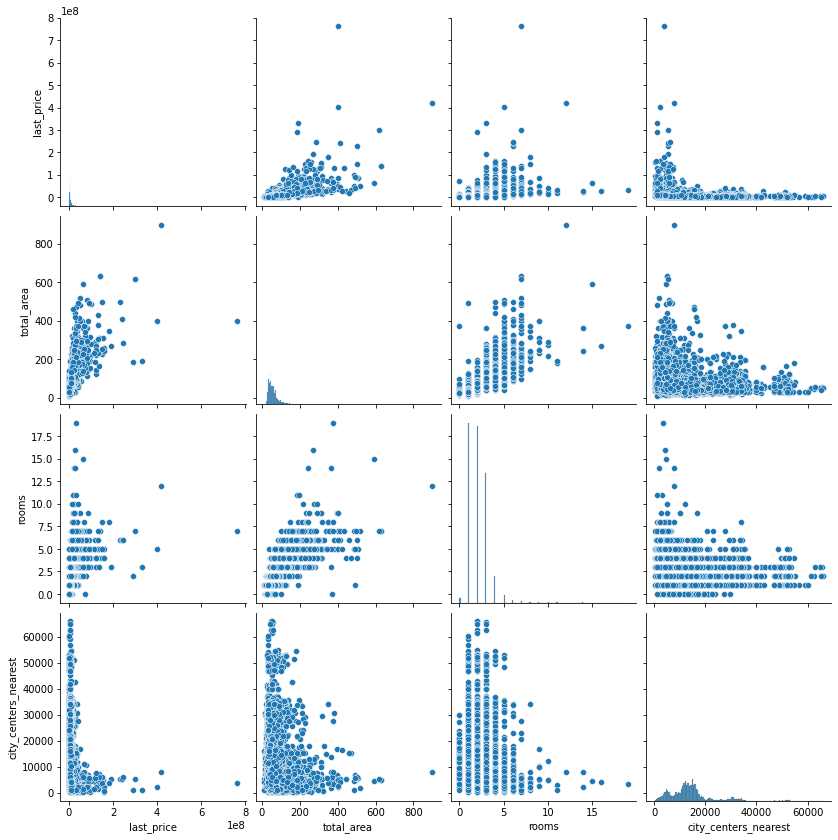

In [110]:
# check
sns.pairplot(data[['last_price', 'total_area', 'rooms', 'city_centers_nearest']])
plt.gcf().set_size_inches(12,12);


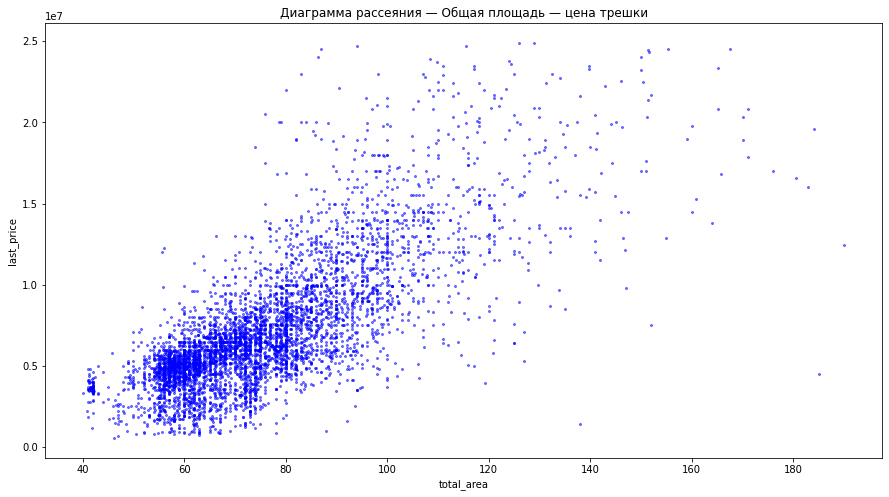

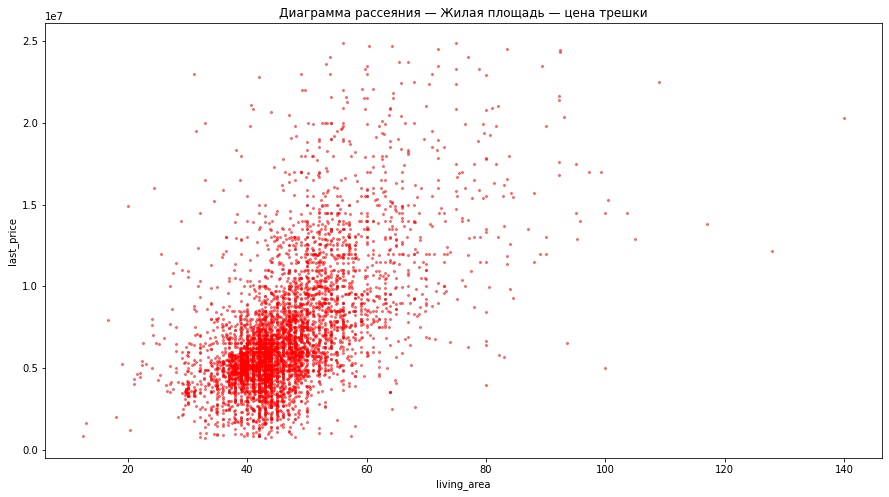

In [111]:
# check
data[data['rooms'] == 3].query('total_area < 201 and last_price < 25_000_000').plot(kind='scatter',
        y='last_price' , x='total_area', alpha=0.5, subplots=True, figsize=(15,8), c = 'b', s = 4)
plt.title('Диаграмма рассеяния — Общая площадь — цена трешки')


data[data['rooms'] == 3].query('total_area < 201 and last_price < 25_000_000').plot(kind='scatter', 
        y='last_price' , x='living_area', alpha=0.5, figsize=(15,8), c = 'r', s = 4)
plt.title('Диаграмма рассеяния — Жилая площадь — цена трешки');